In [ ]:
import os
import shutil
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
import random

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torchvision import datasets, models, transforms
from torchvision.utils import save_image

In [ ]:
def set_random_seed(random_seed=None):
    """
    Using random seed for numpy and torch
    """
    if(random_seed is None):
        random_seed = 13
    os.environ['PYTHONHASHSEED'] = str(random_seed)
    np.random.seed(random_seed)
    torch.manual_seed(random_seed)
    torch.cuda.manual_seed_all(random_seed)
set_random_seed()

In [ ]:
class GaussianNoise:
    """Applies random Gaussian noise to a tensor.

    The intensity of the noise is dependent on the mean of the pixel values.
    See https://arxiv.org/pdf/2101.04909.pdf for more information.

    """

    def __call__(self, sample: torch.Tensor) -> torch.Tensor:
        mu = sample.mean()
        snr = np.random.randint(low=4, high=8)
        sigma = mu / snr
        noise = torch.normal(torch.zeros(sample.shape), sigma)
        return sample + noise

In [ ]:
data_transforms = {
    'train': transforms.Compose([
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        GaussianNoise(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

In [ ]:
train_dataset = torchvision.datasets.StanfordCars(root=".", split="train", transform=data_transforms["train"], download=True)

  0%|          | 0/330960 [00:00<?, ?it/s]

Extracting stanford_cars/car_devkit.tgz to stanford_cars


  0%|          | 0/979269282 [00:00<?, ?it/s]

Extracting stanford_cars/cars_train.tgz to stanford_cars


In [ ]:
valid_dataset = torchvision.datasets.StanfordCars(root=".", split="test", transform=data_transforms["val"], download=True)

Using downloaded and verified file: stanford_cars/car_devkit.tgz
Extracting stanford_cars/car_devkit.tgz to stanford_cars


  0%|          | 0/977350468 [00:00<?, ?it/s]

Extracting stanford_cars/cars_test.tgz to stanford_cars


  0%|          | 0/185758 [00:00<?, ?it/s]

In [ ]:
N_train = len(train_dataset)
N_valid = len(valid_dataset)
print(f"Training set size: {N_train} images")
print(f"Valdiation set size: {N_valid} images")

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=2)
valid_loader = torch.utils.data.DataLoader(valid_dataset, batch_size=32, shuffle=True, num_workers=2)

Training set size: 8144 images
Valdiation set size: 8041 images


In [ ]:
class_names = train_dataset.classes
print(class_names)
print(f"Number of classes = {len(class_names)}")

['AM General Hummer SUV 2000', 'Acura RL Sedan 2012', 'Acura TL Sedan 2012', 'Acura TL Type-S 2008', 'Acura TSX Sedan 2012', 'Acura Integra Type R 2001', 'Acura ZDX Hatchback 2012', 'Aston Martin V8 Vantage Convertible 2012', 'Aston Martin V8 Vantage Coupe 2012', 'Aston Martin Virage Convertible 2012', 'Aston Martin Virage Coupe 2012', 'Audi RS 4 Convertible 2008', 'Audi A5 Coupe 2012', 'Audi TTS Coupe 2012', 'Audi R8 Coupe 2012', 'Audi V8 Sedan 1994', 'Audi 100 Sedan 1994', 'Audi 100 Wagon 1994', 'Audi TT Hatchback 2011', 'Audi S6 Sedan 2011', 'Audi S5 Convertible 2012', 'Audi S5 Coupe 2012', 'Audi S4 Sedan 2012', 'Audi S4 Sedan 2007', 'Audi TT RS Coupe 2012', 'BMW ActiveHybrid 5 Sedan 2012', 'BMW 1 Series Convertible 2012', 'BMW 1 Series Coupe 2012', 'BMW 3 Series Sedan 2012', 'BMW 3 Series Wagon 2012', 'BMW 6 Series Convertible 2007', 'BMW X5 SUV 2007', 'BMW X6 SUV 2012', 'BMW M3 Coupe 2012', 'BMW M5 Sedan 2010', 'BMW M6 Convertible 2010', 'BMW X3 SUV 2012', 'BMW Z4 Convertible 2012

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"device = {device}")

device = cuda


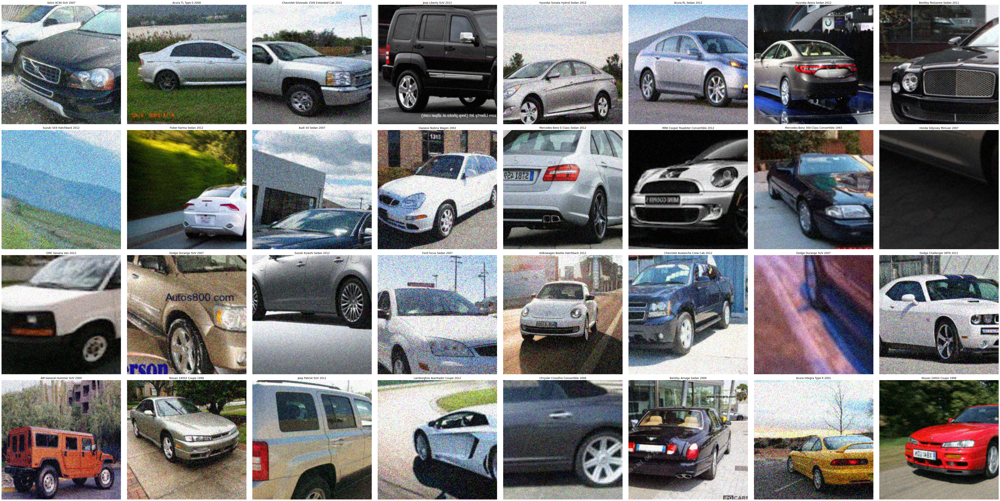

In [ ]:
def show_grid(data, titles=None):
    """Imshow for Tensor."""
    data = data.numpy().transpose((0, 2, 3, 1))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    data = std * data + mean
    data = np.clip(data, 0, 1)
    
    plt.figure(figsize=(8*2*4, 4*2*4))
    for i in range(32):
        plt.subplot(4,8,i+1)
        plt.imshow(data[i])
        plt.axis("off")
        if titles is not None:
            plt.title(titles[i])
    plt.tight_layout()
    plt.show()
            
# Get a batch of training data and displaying it
inputs, classes = next(iter(train_loader))
titles = [class_names[x] for x in classes]

show_grid(inputs, titles=titles)

In [ ]:
# Load the TensorBoard notebook extension
# %load_ext tensorboard (causing problem with colab's GPU)

In [12]:
from torch.utils.tensorboard import SummaryWriter

In [11]:
TBOARD_LOGS = os.path.join(os.getcwd(), "tboard_logs")
if not os.path.exists(TBOARD_LOGS):
    os.makedirs(TBOARD_LOGS)

In [13]:
# shutil.rmtree(TBOARD_LOGS)
writer = SummaryWriter(TBOARD_LOGS)

In [14]:
def train_epoch(model, train_loader, optimizer, criterion, epoch, device):
    """ Training a model for one epoch """
    
    loss_list = []
    for i, (images, labels) in enumerate(train_loader):
        images = images.to(device)
        labels = labels.to(device)
        
        # Clear gradients w.r.t. parameters
        optimizer.zero_grad()
         
        # Forward pass to get output/logits
        outputs = model(images)
         
        # Calculate Loss: softmax --> cross entropy loss
        loss = criterion(outputs, labels)
        loss_list.append(loss.item())
         
        # Getting gradients w.r.t. parameters
        loss.backward()
         
        # Updating parameters
        optimizer.step()
        
    mean_loss = np.mean(loss_list)
    return mean_loss, loss_list


@torch.no_grad()
def eval_model(model, eval_loader, criterion, device):
    """ Evaluating the model for either validation or test """
    correct = 0
    total = 0
    loss_list = []
    
    for images, labels in eval_loader:
        images = images.to(device)
        labels = labels.to(device)
        
        # Forward pass only to get logits/output
        outputs = model(images)
                 
        loss = criterion(outputs, labels)
        loss_list.append(loss.item())
            
        # Get predictions from the maximum value
        preds = torch.argmax(outputs, dim=1)
        correct += len( torch.where(preds==labels)[0] )
        total += len(labels)
                 
    # Total correct predictions and loss
    accuracy = correct / total * 100
    loss = np.mean(loss_list)
    
    return accuracy, loss


def train_model(model, optimizer, scheduler, criterion, train_loader, valid_loader, num_epochs, tboard=None, start_epoch=0):
    """ Training a model for a given number of epochs"""
    
    train_loss = []
    val_loss =  []
    loss_iters = []
    valid_acc = []
    
    for epoch in range(num_epochs):
           
        # validation epoch
        model.eval()  # important for dropout and batch norms
        accuracy, loss = eval_model(
                    model=model, eval_loader=valid_loader,
                    criterion=criterion, device=device
            )
        valid_acc.append(accuracy)
        val_loss.append(loss)
        writer.add_scalar(f'Accuracy/Valid', accuracy, global_step=epoch+start_epoch)
        writer.add_scalar(f'Loss/Valid', loss, global_step=epoch+start_epoch)
        
        # training epoch
        model.train()  # important for dropout and batch norms
        mean_loss, cur_loss_iters = train_epoch(
                model=model, train_loader=train_loader, optimizer=optimizer,
                criterion=criterion, epoch=epoch, device=device
            )
        scheduler.step()
        train_loss.append(mean_loss)
        writer.add_scalar(f'Loss/Train', mean_loss, global_step=epoch+start_epoch)

        loss_iters = loss_iters + cur_loss_iters
        
        if(epoch % 5 == 0 or epoch==num_epochs-1):
            print(f"Epoch {epoch+1}/{num_epochs}")
            print(f"    Train loss: {round(mean_loss, 5)}")
            print(f"    Valid loss: {round(loss, 5)}")
            print(f"    Accuracy: {accuracy}%")
            print("\n")
    
    print(f"Training completed")
    return train_loss, val_loss, loss_iters, valid_acc

In [15]:
def save_model(model, optimizer, epoch, stats):
    """ Saving model checkpoint """
    
    if(not os.path.exists("models")):
        os.makedirs("models")
    savepath = f"models/checkpoint_epoch_{epoch}.pth"

    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'stats': stats
    }, savepath)
    return


def load_model(model, optimizer, savepath):
    """ Loading pretrained checkpoint """
    
    checkpoint = torch.load(savepath)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint["epoch"]
    stats = checkpoint["stats"]
    
    return model, optimizer, epoch, stats


def smooth(f, K=5):
    """ Smoothing a function using a low-pass filter (mean) of size K """
    kernel = np.ones(K) / K
    f = np.concatenate([f[:int(K//2)], f, f[int(-K//2):]])  # to account for boundaries
    smooth_f = np.convolve(f, kernel, mode="same")
    smooth_f = smooth_f[K//2: -K//2]  # removing boundary-fixes
    return smooth_f

In [16]:
def plot_analysis(loss_iters, train_loss, val_loss, valid_acc, title):
    """
    flag: plot accuracy only
    """
    plt.style.use('seaborn')
    fig, ax = plt.subplots(1,3)
    fig.set_size_inches(24,5)
    fig.suptitle(title)
    smooth_loss = smooth(loss_iters, 31)
    ax[0].plot(loss_iters, c="blue", label="Loss", linewidth=3, alpha=0.5)
    ax[0].plot(smooth_loss, c="red", label="Smoothed Loss", linewidth=3, alpha=1)
    ax[0].legend(loc="best")
    ax[0].set_xlabel("Iteration")
    ax[0].set_ylabel("CE Loss")
    ax[0].set_title("Training Progress")

    epochs = np.arange(len(train_loss)) + 1
    ax[1].plot(epochs, train_loss, c="red", label="Train Loss", linewidth=3)
    ax[1].plot(epochs, val_loss, c="blue", label="Valid Loss", linewidth=3)
    ax[1].legend(loc="best")
    ax[1].set_xlabel("Epochs")
    ax[1].set_ylabel("CE Loss")
    ax[1].set_title("Loss Curves")
    
    epochs = np.arange(len(val_loss)) + 1
    ax[2].plot(epochs, valid_acc, c="red", label="Valid accuracy", linewidth=3)
    ax[2].legend(loc="best")
    ax[2].set_xlabel("Epochs")
    ax[2].set_ylabel("Accuracy (%)")
    ax[2].set_title(f"Valdiation Accuracy (max={round(np.max(valid_acc),2)}% @ epoch {np.argmax(valid_acc)+1})")

    plt.show()

In [17]:
def run_experiment(
    model,
    experiments_name,
    train_loader,
    valid_loader,
    num_epochs=15,
    use_scheduler=True,
    
):
    # classification loss function
    criterion = nn.CrossEntropyLoss()

    # Observe that all parameters are being optimized
    optimizer = torch.optim.Adam(model.parameters(), lr=3e-4)

    if use_scheduler:
        # Decay LR by a factor of 0.1 every 7 epochs
        scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)
    else:
        scheduler = None
    
    log_dir = os.path.join(os.getcwd(), "tboard_logs", experiments_name)
    if not os.path.exists(log_dir):
        os.makedirs(log_dir)
    writer = SummaryWriter(log_dir)

    train_loss, val_loss, loss_iters, valid_acc = train_model(
        model=model, optimizer=optimizer, scheduler=scheduler, criterion=criterion,
        train_loader=train_loader, valid_loader=valid_loader, num_epochs=num_epochs, tboard=writer, start_epoch=0
    )

    return train_loss, val_loss, loss_iters, valid_acc


In [18]:
def add_model_classifier(model, model_name, n_classes, freeze_layers=False):
    """
    Method for adding classifer at the top
    """
    if  freeze_layers:
        for param in model.parameters():
            param.requires_grad = False
    if model_name == "resnet":
        num_logits = model.fc.in_features
        model.fc = nn.Linear(num_logits, n_classes)
    
    elif model_name in ["vgg", "mobilenet"]:
        num_logits = model.classifier[-1].in_features
        model.classifier[-1] = nn.Linear(num_logits, n_classes)
    
    

    return model

Fine-tune VGG

In [19]:
vgg16 = models.vgg16(pretrained=True)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

In [20]:
model_name = "vgg"
n_classes = len(class_names)
vgg_model_ft = add_model_classifier(vgg16, model_name, n_classes)
vgg_model_ft = vgg_model_ft.to(device)

In [21]:
experiments_name = "vgg_finetuned"
num_epochs = 5
train_loss_vgg_ft, val_loss_vgg_ft, loss_iters_vgg_ft, valid_acc_vgg_ft = run_experiment(
                                                                                vgg_model_ft,
                                                                                experiments_name,
                                                                                train_loader,
                                                                                valid_loader,
                                                                                num_epochs=num_epochs,
                                                                                use_scheduler=True,
                                                                            )

Epoch 1/5
    Train loss: 5.28777
    Valid loss: 5.33229
    Accuracy: 0.5098868299962691%


Epoch 5/5
    Train loss: 5.27372
    Valid loss: 5.27393
    Accuracy: 0.8456659619450317%


Training completed


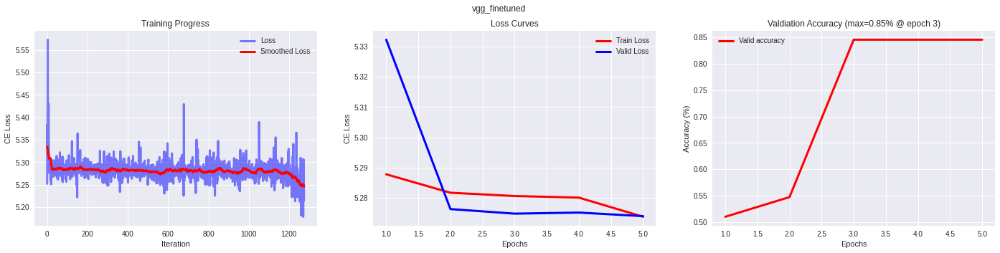

In [22]:
plot_analysis(loss_iters_vgg_ft, train_loss_vgg_ft, val_loss_vgg_ft, valid_acc_vgg_ft, experiments_name)

Fine-tune ResNet

In [23]:
resnet =  torchvision.models.resnet18(pretrained=True)
model_name = "resnet"
n_classes = len(class_names)
resnet_model_ft = add_model_classifier(resnet, model_name, n_classes)
resnet_model_ft = resnet_model_ft.to(device)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

In [24]:
experiments_name = "resnet_finetuned"
num_epochs = 5
train_loss_resnet_ft, val_loss_resnet_ft, loss_iters_resnet_ft, valid_acc_resnet_ft = run_experiment(
                                                                                        resnet_model_ft,
                                                                                        experiments_name,
                                                                                        train_loader,
                                                                                        valid_loader,
                                                                                        num_epochs=num_epochs,
                                                                                        use_scheduler=True,
                                                                                    )

Epoch 1/5
    Train loss: 4.69882
    Valid loss: 5.48685
    Accuracy: 0.7586121129212784%


Epoch 5/5
    Train loss: 1.77462
    Valid loss: 1.49732
    Accuracy: 59.718940430294744%


Training completed


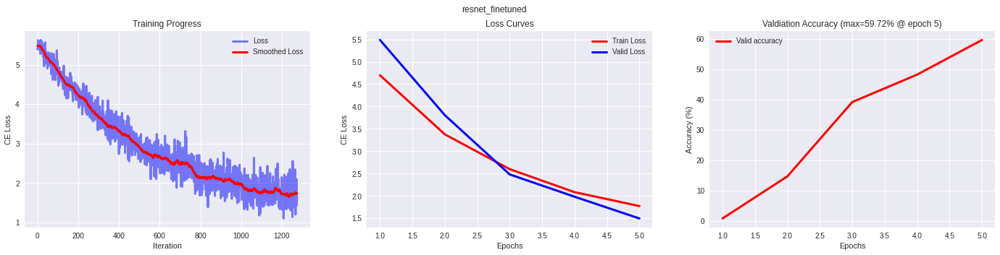

In [26]:
plot_analysis(loss_iters_resnet_ft, train_loss_resnet_ft, val_loss_resnet_ft, valid_acc_resnet_ft, experiments_name)

Fine-tune MobileNet

In [27]:
mobnet =  models.mobilenet_v3_small(pretrained=True)
model_name = "mobilenet"
n_classes = len(class_names)
mobnet_model_ft = add_model_classifier(mobnet, model_name, n_classes)
mobnet_model_ft = mobnet_model_ft.to(device)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V3_Small_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V3_Small_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/mobilenet_v3_small-047dcff4.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_small-047dcff4.pth


  0%|          | 0.00/9.83M [00:00<?, ?B/s]

In [28]:
experiments_name = "mobilenet_finetuned"
num_epochs = 5
train_loss_mobnet_ft, val_loss_mobnet_ft, loss_iters_mobnet_ft, valid_acc_mobnet_ft = run_experiment(
                                                                                        mobnet_model_ft,
                                                                                        experiments_name,
                                                                                        train_loader,
                                                                                        valid_loader,
                                                                                        num_epochs=num_epochs,
                                                                                        use_scheduler=True,
                                                                                    )

Epoch 1/5
    Train loss: 4.91683
    Valid loss: 5.34551
    Accuracy: 0.6218132073125233%


Epoch 5/5
    Train loss: 2.17437
    Valid loss: 3.82884
    Accuracy: 18.865812709861956%


Training completed


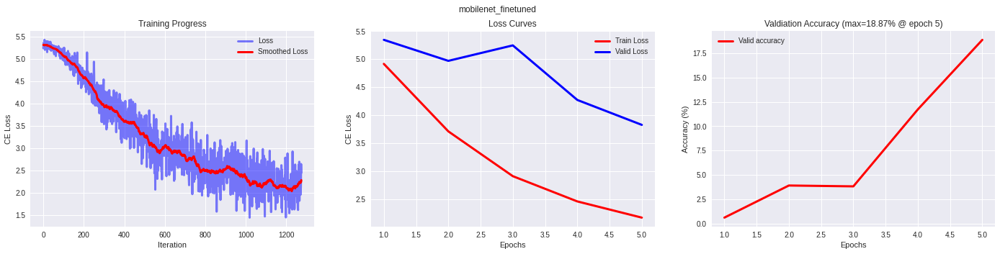

In [29]:
plot_analysis(loss_iters_mobnet_ft, train_loss_mobnet_ft, val_loss_mobnet_ft, valid_acc_mobnet_ft, experiments_name)

ResNet as feature Extractor

In [32]:
resnet_fx =  torchvision.models.resnet18(pretrained=True)
model_name = "resnet"
n_classes = len(class_names)
resnet_model_fx = add_model_classifier(resnet_fx, model_name, n_classes, freeze_layers=True)
resnet_model_fx = resnet_model_fx.to(device)

In [34]:
experiments_name = "resnet_model_feature_extraction"
num_epochs = 5
train_loss_resnet_fx, val_loss_resnet_fx, loss_iters_resnet_fx, valid_acc_resnet_fx = run_experiment(
                                                                                        resnet_model_fx,
                                                                                        experiments_name,
                                                                                        train_loader,
                                                                                        valid_loader,
                                                                                        num_epochs=num_epochs,
                                                                                        use_scheduler=True,
                                                                                    )

Epoch 1/5
    Train loss: 5.31708
    Valid loss: 5.49574
    Accuracy: 0.5223230941425197%


Epoch 5/5
    Train loss: 4.37614
    Valid loss: 4.95925
    Accuracy: 4.340256187041413%


Training completed
